In [2]:
import os
import random
import torch
import requests
from PIL import Image

from super_gradients.training import Trainer, dataloaders, models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050

from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train, 
    coco_detection_yolo_format_val
)

from super_gradients.training.models.detection_models.pp_yolo_e import (
    PPYoloEPostPredictionCallback
)

In [3]:
class config:
    #trainer params
    CHECKPOINT_DIR = 'checkpoints' #specify the path you want to save checkpoints to
    EXPERIMENT_NAME = 'fall_detection' #specify the experiment name
    #dataset params
    DATA_DIR = 'fall_detection_wizobot' #parent directory to where data lives
    TRAIN_IMAGES_DIR = 'train/images' #child dir of DATA_DIR where train images are
    TRAIN_LABELS_DIR = 'train/labels' #child dir of DATA_DIR where train labels are
    VAL_IMAGES_DIR = 'valid/images' #child dir of DATA_DIR where validation images are
    VAL_LABELS_DIR = 'valid/labels' #child dir of DATA_DIR where validation labels are
    # if you have a test set
    TEST_IMAGES_DIR = 'test/images' #child dir of DATA_DIR where test images are
    TEST_LABELS_DIR = 'test/labels' #child dir of DATA_DIR where test labels are

    CLASSES= ['Fall Detected', 'NoFall Detected']
 #what class names do you have

    NUM_CLASSES = len(CLASSES)

    #dataloader params - you can add whatever PyTorch dataloader params you have
    #could be different across train, val, and test
    DATALOADER_PARAMS={
    'batch_size':16,
    'num_workers':2
    }

    # model params
    MODEL_NAME = 'yolo_nas_l' # choose from yolo_nas_s, yolo_nas_m, yolo_nas_l
    PRETRAINED_WEIGHTS = 'coco' #only one option here: coco

In [4]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.TRAIN_IMAGES_DIR,
        'labels_dir': config.TRAIN_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.VAL_IMAGES_DIR,
        'labels_dir': config.VAL_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.TEST_IMAGES_DIR,
        'labels_dir': config.TEST_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

Indexing dataset annotations: 100%|████████████████████████████████████████████████| 101/101 [00:00<00:00, 1077.36it/s]


In [5]:
trainer = Trainer(experiment_name=config.EXPERIMENT_NAME, 
                  ckpt_root_dir=config.CHECKPOINT_DIR)

## load model checkpoint
best_model = models.get(config.MODEL_NAME,
                        num_classes=config.NUM_CLASSES,
                        checkpoint_path=os.path.join('checkpoints/my_first_yolonas_run/average_model.pth'))

Indexing dataset annotations: 100%|██████████████████████████████████████████████████| 51/51 [00:00<00:00, 1086.72it/s]


In [6]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1, 
               top_k_predictions=300, 
               num_cls=config.NUM_CLASSES, 
               normalize_targets=True, 
               post_prediction_callback=PPYoloEPostPredictionCallback(
                  score_threshold=0.01, 
                  nms_top_k=1000, 
                  max_predictions=300,
                  nms_threshold=0.7)
               ))

Testing: 100%|██████████| 3/3 [02:20<00:00, 43.65s/it]

{'Precision@0.50': 0.05020663142204285,
 'Recall@0.50': 0.9594155550003052,
 'mAP@0.50': 0.8491755723953247,
 'F1@0.50': 0.09533858299255371}

In [7]:
tpaths=[]
for dirname, _, filenames in os.walk('C:\\Users\\Ray\\YOLO-NAS\\fall_detection_wizobot\\test\\images\\'):
    for filename in filenames:
        tpaths+=[(os.path.join(dirname, filename))]
print(len(tpaths))

Predicting Images: 100%|███████████████████████████████████████████████████████████████| 51/51 [01:37<00:00,  1.92s/it]


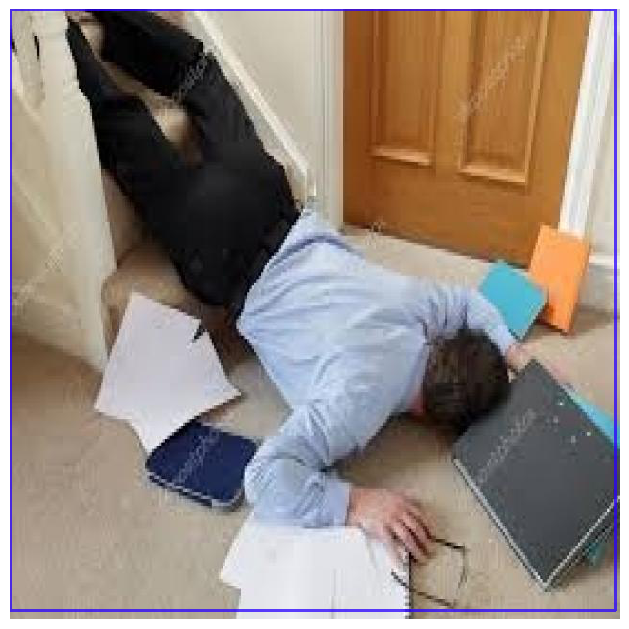

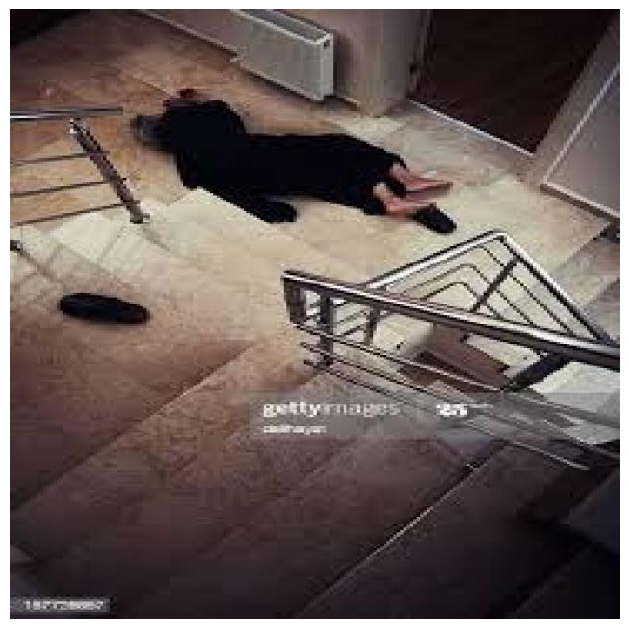

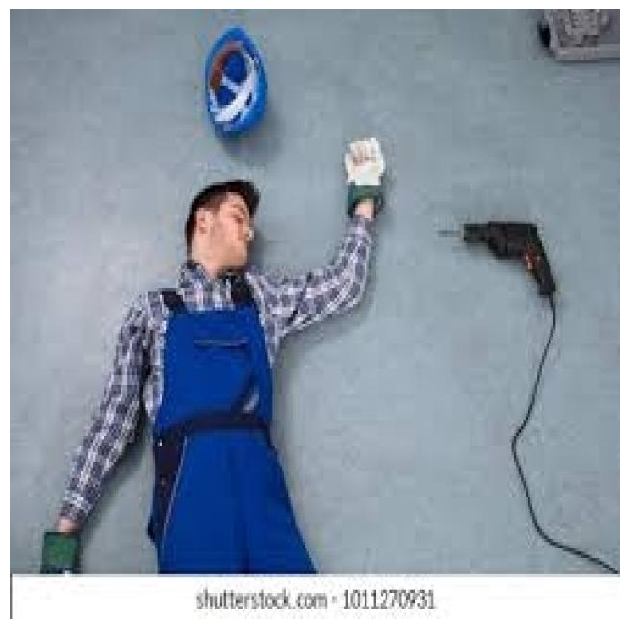

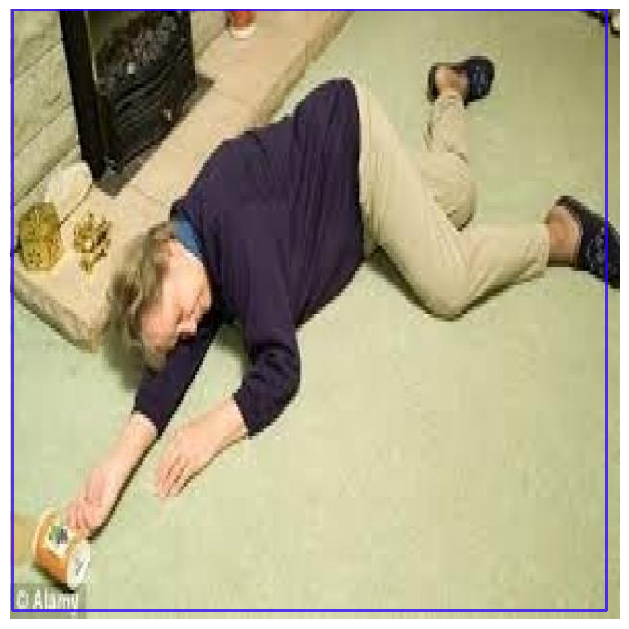

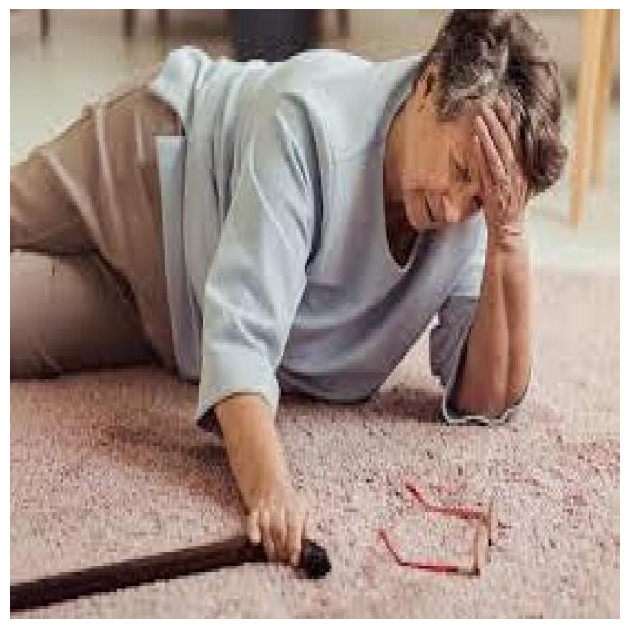

...

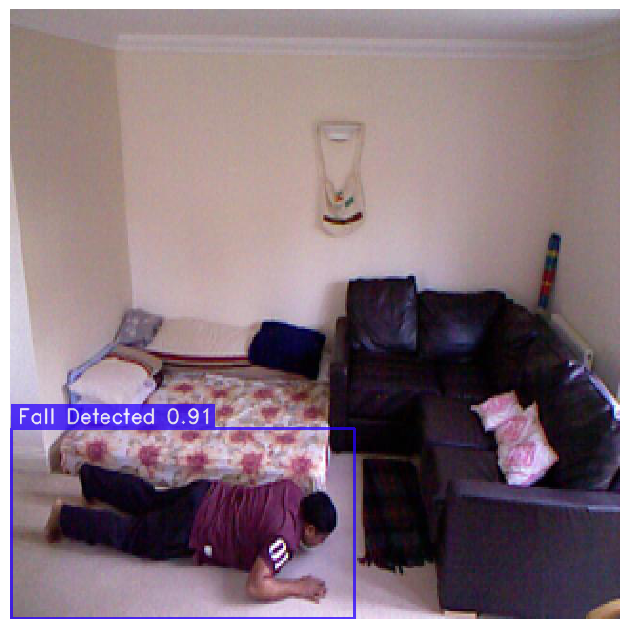

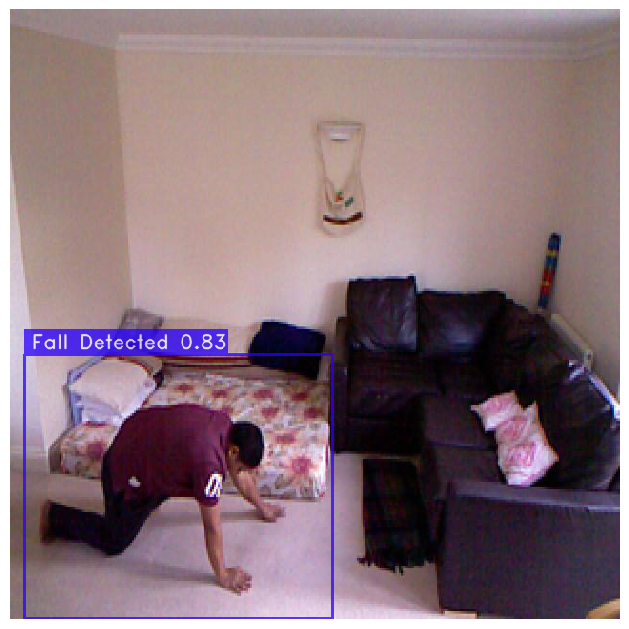

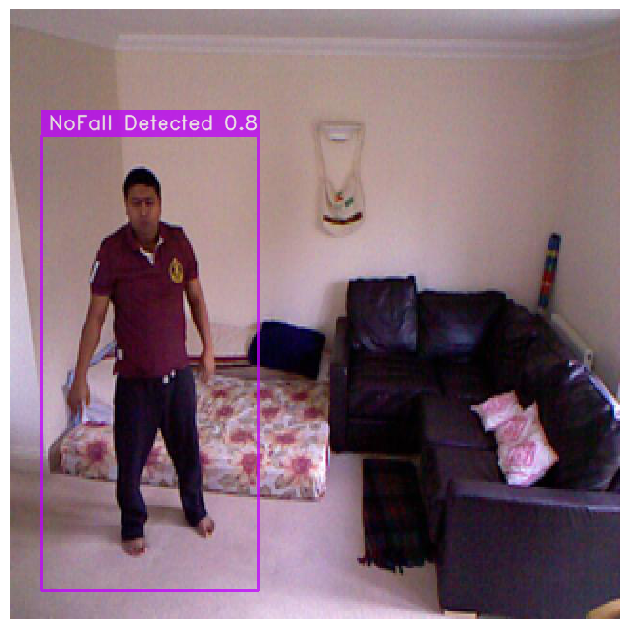

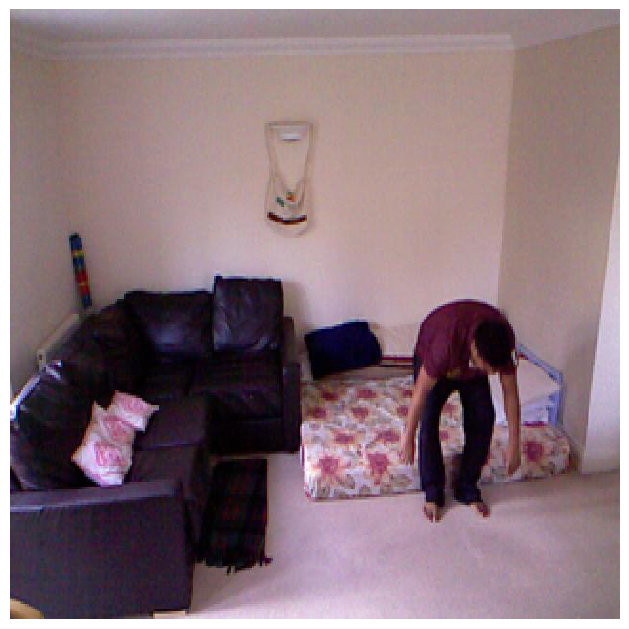

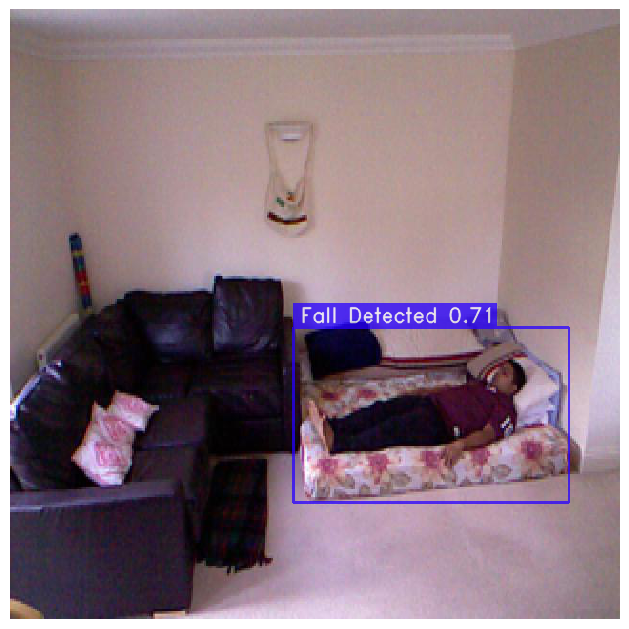

In [8]:
best_model.predict(tpaths, conf=0.7).show()

In [14]:
import time
import pandas as pd
def test_and_measure(model, test_loader, metrics_list):
    start_time = time.time()
    results = trainer.test(model=model, test_loader=test_loader, test_metrics_list=metrics_list)
    end_time = time.time()
    total_time = end_time - start_time
    return results, total_time

# Testing and measuring
results, total_time = test_and_measure(model=best_model, test_loader=test_data, metrics_list=DetectionMetrics_050(score_thres=0.1, top_k_predictions=300, num_cls=config.NUM_CLASSES, normalize_targets=True, post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01, nms_top_k=1000, max_predictions=300, nms_threshold=0.7)))

# Assuming 'results' contains the metrics we need, we format them for CSV
metrics_data = {
    'Metric': [],
    'Value': [],
    'Inference Time (s)': total_time
}

for metric, value in results.items():
    metrics_data['Metric'].append(metric)
    metrics_data['Value'].append(value)

# Convert to DataFrame and save to CSV
df = pd.DataFrame(metrics_data)
csv_file_path = 'metrics_results.csv'
df.to_csv(csv_file_path, index=False)

# Print the metrics and inference time
print("Metrics and inference time saved to", csv_file_path)
print(df)